# Projet PYTHON 
Léa NOIREAUX, Amine MOUSSA, Cécile PAILHE


# Libraries

In [1]:
# essential libraries
import json
import random
from urllib.request import urlopen

# File reading
import glob
from os import name, read
from os.path import basename, splitext

# storing and anaysis
import numpy as np
import pandas as pd
import datetime as dt

# visualization
import matplotlib.pyplot as plt
#import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
from plotly.offline import plot, iplot, init_notebook_mode
#import calmap
#import folium

# converter
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()   

# hide warnings
import warnings
warnings.filterwarnings('ignore')

with open('data/departements-avec-outre-mer.geojson.txt', 'r') as json_file:
        departement = json.load(json_file)


FileNotFoundError: [Errno 2] No such file or directory: 'data/departements-avec-outre-mer.geojson.txt'

# Import Dataset 

In [4]:
# importing datasets
def data_generator(folder_name):
    filepath = glob.glob(folder_name + "/*")
    for file in filepath:  # for each file
        filename = splitext(basename(file))[0] + ".txt"  # File name
        yield filename, pd.read_csv(folder_name + "/" + filename, sep="|")

# Data Cleaning

In [7]:
def data_cleaning(data, perc_NaN):
    print("Processing cleaning...")
    num_cols = len(data.columns)
    print("\n*" + str(data.isna().sum()))

    # drop cols with "n%" of NaN and their NaN rows
    print("\n* Dropping columns with more then " + str(perc_NaN) + "% of NaN")
    min_count =  int(((100-perc_NaN)/100)*data.shape[0] + 1)
    data = data.dropna(axis=1, thresh=min_count)
    print("-> " + str(num_cols - len(data.columns)) + " columns dropped!")
    print("\n* Number of NaN after the first cleaning in the " + str(len(data.columns)) + " columns left:\n" + str(data.isna().sum()))
    data = data.dropna()
    return data

In [8]:
#Ajoute un 0 devant les code de département qui ont qu'un digit
def add0CodeDep(code):
    if len(code)==1:
        code='0'+code
    return code

def convert_data(data):
    # Convert columns
    data["Code commune"] = data['Code commune'].apply(lambda x: str(int(x)))

    data['Code departement']= data['Code departement'].apply(lambda x: str(x))
    data['Code departement'] = data['Code departement'].apply(add0CodeDep)

    data["Code postal"] = data["Code postal"].apply(lambda x: int(x))
    data['Code postal'] = data['Code postal'].apply(lambda x: str(int(x)))

    data['Valeur fonciere']=data['Valeur fonciere'].apply(lambda x: float('.'.join(x.split(','))))

    data['Prix MC ST']=data['Valeur fonciere']/data['Surface terrain'] 
    data['Prix MC ST']=data['Prix MC ST'].apply(lambda x : 0 if x== np.inf else x)
    data['Prix MC SRB']=data['Valeur fonciere']/data['Surface reelle bati'] 
    data['Prix MC SRB']=data['Prix MC SRB'].apply(lambda x : 0 if x== np.inf else x)
    
    data['Nombre de vente']=1 #crée une colonne pour le nombre de vente remplie de 1 
    return data

# _____ Main _____

In [9]:
# Create a dictionnary with clean datasets
clean_datasets = {}
for filename, data in data_generator("data/Valeurs Foncieres"):
    # Extract year from filename
    year = ''.join([ch for ch in filename if ch in '0123456789'])
    print("\n----> Year: " + year)
    
    # Clean data by dropping useless cols and rows / Converting values
    clean_data = data_cleaning(data, perc_NaN=50)
    clean_data = convert_data(clean_data)
    clean_datasets[year] = clean_data

# Display data of 2020
clean_datasets["2020"]


----> Year: 2016
Processing cleaning...

*Code service CH               2939478
Reference document            2939478
1 Articles CGI                2939478
2 Articles CGI                2939478
3 Articles CGI                2939478
4 Articles CGI                2939478
5 Articles CGI                2939478
No disposition                      0
Date mutation                       0
Nature mutation                     0
Valeur fonciere                 35643
No voie                       1257084
B/T/Q                         2816323
Type de voie                  1292701
Code voie                       23310
Voie                            23338
Code postal                     23494
Commune                             0
Code departement                    0
Code commune                        0
Prefixe de section            2837406
Section                           106
No plan                             0
No Volume                     2927451
1er lot                       2050131
Surface

,No disposition,Date mutation,Nature mutation,Valeur fonciere,No voie,Type de voie,Code voie,Voie,Code postal,Commune,...,Nombre de lots,Code type local,Type local,Surface reelle bati,Nombre pieces principales,Nature culture,Surface terrain,Prix MC ST,Prix MC SRB,Nombre de vente
13,1,06/01/2020,Vente,180300.0,31.0,RUE,0970,COMTE DE LA TEYSSONNIERE,1000,BOURG-EN-BRESSE,...,0,1.0,Maison,75.0,4.0,S,525.0,343.428571,2404.000000,1
16,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,1.0,Maison,201.0,7.0,J,1267.0,276.835043,1745.024876,1
17,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,1.0,Maison,201.0,7.0,S,1497.0,234.301937,1745.024876,1
18,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,3.0,Dépendance,0.0,0.0,S,1497.0,234.301937,0.000000,1
19,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,3.0,Dépendance,0.0,0.0,J,1267.0,276.835043,0.000000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2459554,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,2.0,Appartement,27.0,2.0,S,447.0,4334.451902,71759.259259,1
2459555,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,2.0,Appartement,87.0,4.0,S,447.0,4334.451902,22270.114943,1
2459556,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,3.0,Dépendance,0.0,0.0,S,447.0,4334.451902,0.000000,1
2459557,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,2.0,Appartement,82.0,2.0,S,447.0,4334.451902,23628.048780,1


,No disposition,Date mutation,Nature mutation,Valeur fonciere,No voie,Type de voie,Code voie,Voie,Code postal,Commune,...,Nombre de lots,Code type local,Type local,Surface reelle bati,Nombre pieces principales,Nature culture,Surface terrain,Prix MC ST,Prix MC SRB,Nombre de vente
13,1,06/01/2020,Vente,180300.0,31.0,RUE,0970,COMTE DE LA TEYSSONNIERE,1000,BOURG-EN-BRESSE,...,0,1.0,Maison,75.0,4.0,S,525.0,343.428571,2404.000000,1
16,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,1.0,Maison,201.0,7.0,J,1267.0,276.835043,1745.024876,1
17,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,1.0,Maison,201.0,7.0,S,1497.0,234.301937,1745.024876,1
18,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,3.0,Dépendance,0.0,0.0,S,1497.0,234.301937,0.000000,1
19,1,03/01/2020,Vente,350750.0,904.0,CHE,0149,DES GDES CADALLES,1000,SAINT-DENIS-LES-BOURG,...,0,3.0,Dépendance,0.0,0.0,J,1267.0,276.835043,0.000000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2459554,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,2.0,Appartement,27.0,2.0,S,447.0,4334.451902,71759.259259,1
2459555,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,2.0,Appartement,87.0,4.0,S,447.0,4334.451902,22270.114943,1
2459556,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,3.0,Dépendance,0.0,0.0,S,447.0,4334.451902,0.000000,1
2459557,1,16/12/2020,Vente,1937500.0,24.0,RUE,1748,CHANOINESSE,75004,PARIS 04,...,0,2.0,Appartement,82.0,2.0,S,447.0,4334.451902,23628.048780,1


________________________________________________________________________________
# **Interprétations et visualisations autour d'une année (en particulier 2020)**
________________________________________________________________________________

## *1) Nombre de vente en fonction de l'année (par département et ville)* ##

### Par departement

In [10]:
def Number_SalesPer(data, column, year):
    X=data.groupby([column])[column].count() #count the number of sale/department (each time a department appear, sale ++
    txt = "Nombre de ventes par " + column + " en " + year
    figure=px.bar(X, barmode='relative',color=X, color_discrete_sequence=px.colors.qualitative.G10, title=txt,height=600, width=1000, labels=[column, "Nombre de ventes"])
    #color_discrete_sequence= px.colors.sequential.Plasma_r
    #figure.show()
    return figure



In [11]:
#Nombre de vente par departement
year = "2020"
clean_data = clean_datasets[year]
Number_SalesPer(clean_data, 'Code departement', year)

### Par ville (code Postal)

In [12]:
#Nombre de vente par ville (code postal) (Graph peut intéressant car beaucoup trop de ville)
year = "2016"
clean_data = clean_datasets[year]
Number_SalesPer(clean_data, 'Code postal', year)

## *2) Nombre de ventes par Commune d'un département*

In [13]:
def Number_SalesPer_Commune(data, departement, year):
    data['Nombre de vente']=1
    Y=data[(data['Code departement'] == departement)] #prend que les lignes du département concerné   
    X=Y.groupby(['Commune'])['Nombre de vente'].count().reset_index() #trouve le nombre de vente par commune du département   
    txt = "Nombre de vente par commune du " + departement + " en "  + year
    figure=px.treemap(X, path=['Commune'], values='Nombre de vente',color_discrete_sequence = px.colors.qualitative.Dark2, title=txt,height=600, width=1000)
    figure.data[0].textinfo = 'label+value' #pour afficher le nom de la commune et le nombre de vente
    #figure.show()
    return figure

In [14]:
#Nombre de vente par commune d'un departement
year = "2019"
clean_data = clean_datasets[year]

# Departement
clean_data
Number_SalesPer_Commune(clean_data, '92', year)

## *3) Top communes ayant le plus de vente* ###

In [15]:
def Communes_Top_Ventes(data, year, n, hover_data=[]):
    data['Nombre de vente']=1
    b=data.groupby(['Commune'])['Nombre de vente'].count().reset_index() #trouve le nombre de vente par commune du département   
    fig = px.bar(b.sort_values('Nombre de vente', ascending=True).tail(n), 
                 x='Nombre de vente', y="Commune", color='Nombre de vente',  
                 text='Commune', orientation='h', width=700, hover_data=hover_data,
                 color_discrete_sequence = px.colors.qualitative.Dark2)
    fig.update_layout(title="Top des " + str(n) + " communes avec le plus de ventes en France en " + year, xaxis_title="", yaxis_title="", 
                      yaxis_categoryorder = 'total ascending',
                      uniformtext_minsize=8, uniformtext_mode='hide')
    fig.show()

In [16]:
# Nombre de vente par commune d'un departement
year = "2020"
clean_data = clean_datasets[year]
Communes_Top_Ventes(clean_data, year, 20)

##	*4) Prix moyen du mètre carré de la surface réelle bâti d'un département sur une année.* ### 


In [17]:
# donne des valeurs étranges (Se concentrer sur la surface de terrain et non la surface réelle bâti)
def AvgPrix_MCSurfaceBati_Dep(data, year):
    X=data.groupby(['Code departement'])['Prix MC SRB'].mean()
    txt = "Prix moyen du mètre carré de la surface réelle bâtie par département en " + year
    figure=px.bar(X, color=X, barmode='relative',color_discrete_sequence=px.colors.qualitative.G10, title=txt,height=600, width=1000)
    return figure

In [18]:
# Prix moyen du mètre carré de la surface réelle bâti d'un département sur une année.
year = "2019"
clean_data = clean_datasets[year]
AvgPrix_MCSurfaceBati_Dep(clean_data, year)

##	*5) Prix moyen du mètre carré de la surface de terrain d'un département sur une année.* ### 

In [19]:

#les résultats paraissent plus cohérents mais certaines valeurs restent étranges (Paris)
def AvgPrice_MCTerrain_Dep(data, year):
    X=data.groupby(['Code departement'])['Prix MC ST'].mean()
    txt = "Prix moyen du mètre carré de la surface de terrain par département en " + year 
    figure=px.bar(X, color=X, barmode='relative',color_discrete_sequence=px.colors.qualitative.G10, title=txt,height=600, width=1000)
    return figure

In [20]:
# Prix moyen du mètre carré de la surface de terrain par département
year = "2018"
clean_data = clean_datasets[year]
AvgPrice_MCTerrain_Dep(clean_data, year)

##	*6) Prix moyen du mètre carré de la surface de terrain des communes d'un département sur une année.* ### 

In [21]:
def AvgPrice_MCTerrain_Commune(data, departement, year):
    Y=data[(data['Code departement'] == departement)] #prend que les lignes du département concerné   
    X=Y.groupby(['Commune'])['Prix MC ST'].mean()    
    txt = "Prix moyen du mètre carré de la surface de terrain par commune du " + departement + " en " + year
    figure=px.bar(X, color=X, barmode='relative',color_discrete_sequence=px.colors.qualitative.G10, title=txt,height=600, width=1000)
    return figure

In [22]:
# Prix moyen du mètre carré de la surface de terrain des communes d'un département
year = "2020"
clean_data = clean_datasets[year]
AvgPrice_MCTerrain_Commune(clean_data, '75', year)

## *7) Surface Terrain en Fonction de la narutre de culture* ##

In [25]:
def SurfaceTerrain_NatureCulture(data, year):
    d = data.copy()
    d= d.replace('', np.nan).fillna(0)
    d.drop(d[d['Nature culture'] ==0].index, inplace = True)
    txt = "Surface des terrains en fonction de la nature des cultures en " + year
    fig = px.treemap(d, path=["Nature culture"], values="Surface terrain", height=500, width=1000, title=txt, color_discrete_sequence=px.colors.qualitative.G10)
    fig.data[0].textinfo = 'label+text+value'
    return fig

In [26]:
# Prix moyen du mètre carré de la surface de terrain des communes d'un département
year = "2017"
clean_data = clean_datasets[year]
SurfaceTerrain_NatureCulture(clean_data, year)

## *8) Proportion type de bien* ##

In [27]:
year = "2017"
clean_data = clean_datasets[year]
fig = px.pie(clean_data, names="Nature mutation", height=700, width= 1000, title="proportion des types de bien en " + year)
fig

## *9) Répartition par type de local* ##

In [28]:
def Repartion_TypeLocal(data, year):  
    X=data.groupby(by='Type local').size().reset_index(name='total')
    txt = 'Répartition par type de local en ' + year
    fig = px.treemap(X,title=txt, path=["Type local"], values='total', height=400, width=1000, color_discrete_sequence=['red','orange', 'gold', 'yellow'])
    fig.data[0].textinfo = 'label+value'
    return fig

In [29]:
# Répartition par type de local
year = "2018"
clean_data = clean_datasets[year]
Repartion_TypeLocal(clean_data, year)

## *10) Valeur Fonciere en fonction de la nature de mutation* ##

In [30]:
def ValeurFonciere_NatureMutation(data, year):
    df=data.copy()
    df.drop(df[df['Nature mutation'] ==0].index, inplace = True)
    df.drop(df[df['Valeur fonciere'] >=1500000].index, inplace = True)
    df["Nature mutation"] = df["Nature mutation"].astype(str)
    df["Date mutation"]=pd.to_datetime(df["Date mutation"], format="%d/%m/%Y")
    df.sort_values(by='Date mutation')
    fig = px.scatter(df[::100],x="Date mutation",y="Valeur fonciere",color="Nature mutation", height=600, width=1150)
    return fig

In [31]:
# Valeur Fonciere en fonction de la nature de mutation
year = "2020"
clean_data = clean_datasets[year]
ValeurFonciere_NatureMutation(clean_data, year)

## *11) Valeur fonciere en fonction du nb de pieces principales* ##

In [32]:
def ValeurFonciere_NbPiecesP(data, year):
    df = data.copy()
    df.drop(df[df['Nombre pieces principales'] ==0].index, inplace = True)
    df.drop(df[df['Valeur fonciere'] >=1500000].index, inplace = True)
    fig = px.scatter(df[::100],x="Valeur fonciere",y="Nombre pieces principales", color= "Valeur fonciere", height=600, width=1000)
    return fig

In [33]:
# Valeur Fonciere en fonction de la nature de mutation
year = "2016"
clean_data = clean_datasets[year]
ValeurFonciere_NbPiecesP(clean_data, year)

## *12) Carte de France et prix moyen du MC (surface terrain) par département* ##

In [35]:
no_departement_map = {}
for feature in departement["features"]:
    feature["id"] = feature["properties"]["nom"]    
    no_departement_map[feature["properties"]["code"]] = feature["id"]

In [36]:
def Map_AvgPrice_MCTerrain_Dep(data, year):
    X=data.groupby(['Code departement'])['Prix MC ST'].mean().reset_index() 
    X["id"]=X["Code departement"].apply(lambda x: no_departement_map[x])
    txt = "Prix moyen du m² de surface de terrain par département en France en " + year
    fig = px.choropleth(X, color='Prix MC ST', locations = 'id', geojson=departement, scope='europe', color_continuous_scale="RdGy",title=txt, height=600, width=1000)
    return fig

In [37]:
# Prix moyen du mètre carré de la surface de terrain des communes d'un département
year = "2017"
clean_data = clean_datasets[year]
Map_AvgPrice_MCTerrain_Dep(clean_data, year)

## *13) Carte de France et nombre de vente par département* ### 

In [38]:
def Map_NombreVente_dep(data, year):
    X=data.groupby(['Code departement'])['Nombre de vente'].count().reset_index() #trouve le nombre de vente par département   
    X["id"]=X["Code departement"].apply(lambda x: no_departement_map[x]) 
    txt = 'Nombre ventes par département en ' + year
    fig = px.choropleth(X, color='Nombre de vente', locations = 'id', geojson=departement, scope='europe', color_continuous_scale="RdGy", title=txt, height=600, width= 1000)
    return fig

In [39]:
# Carte de France et nombre de vente par département
year = "2020"
clean_data = clean_datasets[year]
Map_NombreVente_dep(clean_data, year)

## *14) Valeur fonciere par département et par année (comparaison de tous les départements)* ###

In [40]:
# Boite à moustache sur la valeur fonciere des départements de France sur une année
def Bar_ValeurFonciere_dep(data, year):  
   txt = 'Distribution de la valeur fonciere dans les départements de France en ' + year
   figure= px.box(data, x='Code departement', y='Valeur fonciere', points=False,color='Code departement', title=txt, height=600,   width=1000)
   return figure

In [41]:
# Valeur fonciere par département et par année
year = "2020"
clean_data = clean_datasets[year]
Bar_ValeurFonciere_dep(clean_data, year)

## *16) Valeur fonciere par département et par année (un département)* ###

In [42]:
# Boite à moustache sur la valeur fonciere d'un département en particulier sur une année
def BoxP_ValeurFonciere_dep(data, year, departement):
    X=data[(data['Code departement'] == departement)]
    txt = 'Distribution de la valeur fonciere dans le ' + departement + " en " + year
    figure= px.box(X, x='Code departement', y='Valeur fonciere', points=False,color='Code departement',title=txt, height=600, width=1000)
    return figure

In [43]:
# Valeur fonciere par département et par année
year = "2017"
clean_data = clean_datasets[year]
BoxP_ValeurFonciere_dep(clean_data, year, "90")

## *17) Boxplot sur la valeur fonciere par commune et par année (une commune)* ###

In [44]:
#Boite à moustache sur la valeur fonciere d'une commune en particulier sur une année
def BoxP_ValeurFonciere_commune(data, year, commune):
    X=data[(data['Commune'] == commune)]
    txt = "Distribution de la valeur fonciere à " + commune + " de France en " + year
    figure= px.box(X, x='Commune', y='Valeur fonciere', points=False,color='Commune', title=txt, height=600, width=1000)
    return figure

In [45]:
# Valeur fonciere par département et par année
year = "2017"
clean_data = clean_datasets[year]
BoxP_ValeurFonciere_commune(clean_data, year, 'RUEIL-MALMAISON')

## *18) Nombre de piece principales par surface reelle batie* ##

In [46]:
def Moustache_NbrPiece_SRBatie(data, year):
    df=data.copy()[::100]
    df.drop(df[df['Nombre pieces principales'] ==0].index, inplace = True)
    df.drop(df[df['Nombre pieces principales'] >10].index, inplace = True)
    txt = "Nombre de piece principales par surface reelle batie en " + year
    fig = px.box(df, x="Nombre pieces principales", y="Surface reelle bati", title=txt, height=600, width=1000)
    return fig

In [47]:
# Nombre de piece principales par surface reelle batie
year = "2020"
clean_data = clean_datasets[year]
Moustache_NbrPiece_SRBatie(clean_data, year)

In [79]:
dataCovid = pd.read_csv("data/covid data/worldometer_data.csv", sep=";")
dataCovid.dtypes
dataCovid.Date = dataCovid.Date.apply(lambda x: dt.datetime.strptime(x, '%d/%m/%Y'))
dataCovid.dtypes
Map_Covid(dataCovid)

ValueError: Value of 'hover_name' is not the name of a column in 'data_frame'. Expected one of ['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'New cases', 'New deaths', 'New recovered', 'Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered', 'No. of countries'] but received: Country/Region

In [71]:
## *19) Cas covid en Fonction des transactions* ##
def NewCases_Transaction_TimeSeries(data2020, dataCovid):
    df = data2020.copy()
    df['Nombre de Transactions']=1
    df["Date mutation"]=pd.to_datetime(df["Date mutation"], format="%d/%m/%Y")
    df
    X=df.groupby(['Date mutation'])['Nombre de Transactions'].count().reset_index()
    fig = px.line(df,x="Date mutation",y="Nombre de Transactions", height=600, width=1000)
    #fig.add_hline(x=fruits, y=[2,1,3], name="Last year")
    return fig

In [54]:
# Prepare Covid data
dataCovid = pd.read_csv("data/covid data/dataCovid.csv", sep=";")
clean_dataCovid = data_cleaning(dataCovid, perc_NaN=20)


Processing cleaning...

*Date                      0
Confirmed                 0
Deaths                    0
Recovered                 0
Active                    0
New cases                 0
New deaths                0
New recovered             0
Deaths / 100 Cases        0
Recovered / 100 Cases     0
Deaths / 100 Recovered    0
No. of countries          0
dtype: int64

* Dropping columns with more then 20% of NaN
-> 0 columns dropped!

* Number of NaN after the first cleaning in the 12 columns left:
Date                      0
Confirmed                 0
Deaths                    0
Recovered                 0
Active                    0
New cases                 0
New deaths                0
New recovered             0
Deaths / 100 Cases        0
Recovered / 100 Cases     0
Deaths / 100 Recovered    0
No. of countries          0
dtype: int64


In [72]:
# Cas covid en Fonction des transactions
clean_data = clean_datasets["2020"]
NewCases_Transaction_TimeSeries(clean_data, clean_dataCovid)

## *20) Cas Covid en Fonction des transactions* ##

In [48]:

dataCovid = pd.read_csv("data/covid data/dataCovid.csv", sep=";")
clean_dataCovid = data_cleaning(dataCovid, perc_NaN=20)
clean_dataCovid

Processing cleaning...

*Date                      0
Confirmed                 0
Deaths                    0
Recovered                 0
Active                    0
New cases                 0
New deaths                0
New recovered             0
Deaths / 100 Cases        0
Recovered / 100 Cases     0
Deaths / 100 Recovered    0
No. of countries          0
dtype: int64

* Dropping columns with more then 20% of NaN
-> 0 columns dropped!

* Number of NaN after the first cleaning in the 12 columns left:
Date                      0
Confirmed                 0
Deaths                    0
Recovered                 0
Active                    0
New cases                 0
New deaths                0
New recovered             0
Deaths / 100 Cases        0
Recovered / 100 Cases     0
Deaths / 100 Recovered    0
No. of countries          0
dtype: int64


,Date,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,No. of countries
0,22/01/2020,555,17,28,510,0,0,0,3.06,5.05,60.71,6
1,23/01/2020,654,18,30,606,99,1,2,2.75,4.59,60.00,8
2,24/01/2020,941,26,36,879,287,8,6,2.76,3.83,72.22,9
3,25/01/2020,1434,42,39,1353,493,16,3,2.93,2.72,107.69,11
4,26/01/2020,2118,56,52,2010,684,14,13,2.64,2.46,107.69,13
...,...,...,...,...,...,...,...,...,...,...,...,...
183,23/07/2020,15510481,633506,8710969,6166006,282756,9966,169714,4.08,56.16,7.27,187
184,24/07/2020,15791645,639650,8939705,6212290,281164,6144,228736,4.05,56.61,7.16,187
185,25/07/2020,16047190,644517,9158743,6243930,255545,4867,219038,4.02,57.07,7.04,187
186,26/07/2020,16251796,648621,9293464,6309711,204606,4104,134721,3.99,57.18,6.98,187


In [ ]:
## 20) 
def CasCovid_2020(data, year):   
    df = data.copy()
    df["Date mutation"]=pd.to_datetime(df["Date mutation"], format="%d/%m/%Y")
    df.drop(df[df['Date mutation'].dt.month == 8].index, inplace = True)
    df.drop(df[df['Date mutation'].dt.month == 9].index, inplace = True)
    df.drop(df[df['Date mutation'].dt.month == 10].index, inplace = True)
    df.drop(df[df['Date mutation'].dt.month == 11].index, inplace = True)
    df.drop(df[df['Date mutation'].dt.month == 12].index, inplace = True)
    c=  list(df["Date mutation"].value_counts())
    
    df['New cases']=clean_dataCovid['New cases']
    df['Date']=clean_dataCovid['Date']
    df["Date"]=pd.to_datetime(df["Date"], format="%d/%m/%Y")
    dbis = pd.DataFrame({'Date': df['Date'],'New cases':df['New cases'],'Date mutation':df['Date mutation'],'total':df['total']})

    fig = make_subplots(specs=[[{"secondary_y": True}]])

    # Add traces
    fig.add_trace(
        go.Scatter(x=dbis['Date'], y=dbis['New cases'], name="nouveau cas de covid"),
        secondary_y=False,
    )
    fig.add_trace(
        go.Scatter(x=dbis['Date'], y=c, name="nombre de vente"),
        secondary_y=True,
    )
    fig.update_layout(title_text="title")
    fig.update_xaxes(title_text="date")
    fig.update_yaxes(title_text=" Nouveau cas covid", secondary_y=False)
    fig.update_yaxes(title_text=" nombre de transactions immobilières", secondary_y=True)
    return fig

In [ ]:
# Cas covid en 2020
year = "2020"
clean_data = clean_datasets[year]
CasCovid_2020(data, year)

KeyError: 'total'

________________________________________________________________________________

# **Interprétations et visualisations en comparaison avec d'autres années** #
________________________________________________________________________________


## *1)	Nombre de ventes par année*  ###

In [ ]:
def NombreVentes_PerYear(dataset):
    X=pd.DataFrame({'Nombre de vente': [len(dataset["2016"]),
                                        len(dataset["2017"]),
                                        len(dataset["2018"]),
                                        len(dataset["2019"]),
                                        len(dataset["2020"])],
                    'Annee':['2016', '2017', '2018', '2019', '2020']})
    figure=X.plot.bar(x='Annee',rot=0, title="Nombre de vente par année")
    return figure
    

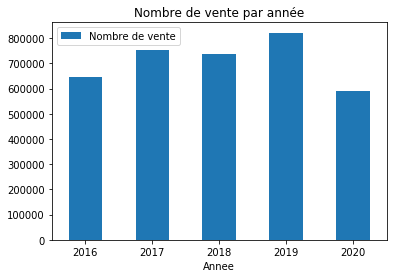

In [ ]:
# Nombre de vente par année
NombreVentes_PerYear(clean_datasets)

## *2) Nombre de vente d'appartement/maison/dépendance sur les 5 années* ##

In [ ]:
def NbrVentesLocal_TimeSeries(dataset, type_local):
    a=len(dataset["2016"][(dataset["2016"]['Type local'] == type_local)])
    b=len(dataset["2017"][(dataset["2017"]['Type local'] == type_local)])
    c=len(dataset["2018"][(dataset["2018"]['Type local'] == type_local)])
    d=len(dataset["2019"][(dataset["2019"]['Type local'] == type_local)])
    e=len(dataset["2020"][(dataset["2020"]['Type local'] == type_local)])
    
    txt = "Nombre de vente de " + type_local + " par année"
    b=pd.DataFrame({txt: [a,b,c,d,e],'Annee':['2016', '2017', '2018', '2019', '2020']})
    figure=b.plot.bar(x='Annee',rot=0, title=txt)
    return figure
    

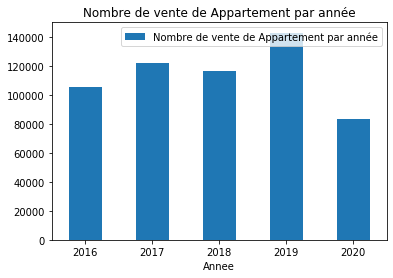

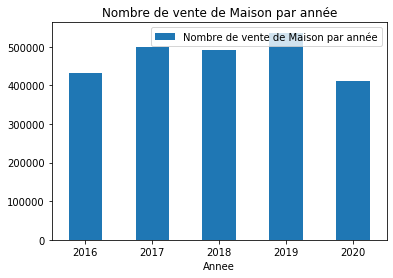

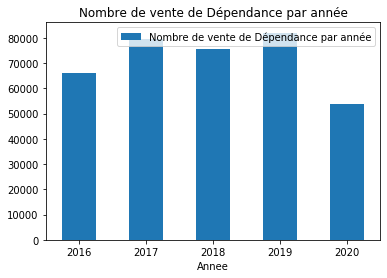

In [ ]:
# Nombre de vente d'appartement
NbrVentesLocal_TimeSeries(clean_datasets, "Appartement")
NbrVentesLocal_TimeSeries(clean_datasets, "Maison")
NbrVentesLocal_TimeSeries(clean_datasets, "Dépendance")

## *3) Prix du MC dans un département sur les 5 ans* ##

In [ ]:
def AvgPrice_MC_Dep(dataset, departement):    
    a=dataset["2016"].groupby(['Code departement'])['Prix MC ST'].mean()
    b=dataset["2017"].groupby(['Code departement'])['Prix MC ST'].mean()
    c=dataset["2018"].groupby(['Code departement'])['Prix MC ST'].mean()
    d=dataset["2019"].groupby(['Code departement'])['Prix MC ST'].mean()
    e=dataset["2020"].groupby(['Code departement'])['Prix MC ST'].mean()
    
    txt = "Prix moyen du MC dans le " + departement + " sur les 5 ans"
    b=pd.DataFrame({txt: [a[departement],b[departement],c[departement],d[departement],e[departement]],'Annee':['2016', '2017', '2018', '2019', '2020']})
    
    figure=b.plot.bar(x='Annee',rot=0, title=txt)
    return figure

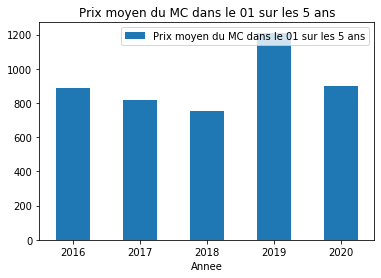

In [ ]:
# Prix du MC dans un département sur les 5 ans
AvgPrice_MC_Dep(clean_datasets, "01")

## *4) Prix moyen du MC dans une commune sur les 5 ans* ###

In [ ]:
def AvgPrice_MC_Commune(dataset, commune):    
    a=dataset["2016"].groupby(['Commune'])['Prix MC ST'].mean()
    b=dataset["2017"].groupby(['Commune'])['Prix MC ST'].mean()
    c=dataset["2018"].groupby(['Commune'])['Prix MC ST'].mean()
    d=dataset["2019"].groupby(['Commune'])['Prix MC ST'].mean()
    e=dataset["2020"].groupby(['Commune'])['Prix MC ST'].mean()
    
    txt = "Prix moyen MC à " + commune + " de 2016 à 2020"
    X=pd.DataFrame({txt: [a[commune],b[commune],c[commune],d[commune],e[commune]],'Annee':['2016', '2017', '2018', '2019', '2020']})
    figure=X.plot.bar(x='Annee',rot=0, title=txt)
    return figure

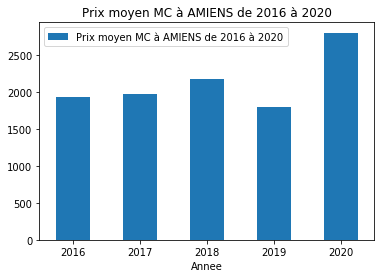

In [ ]:
# Prix moyen du MC dans une commune sur 5 ans
AvgPrice_MC_Commune(clean_datasets, 'AMIENS')

## *5) Nature de mutation en fct de la valeur fonciere moyenne* ##

In [ ]:
def Avg_ValeurFonciere_NatureMutation(data_year_1, data_year_2, data_year_3):
    moy1 =  list(data_year_1.groupby("Nature mutation")["Valeur fonciere"].mean())
    moy2 =  list(data_year_2.groupby("Nature mutation")["Valeur fonciere"].mean())
    moy3 =  list(data_year_3.groupby("Nature mutation")["Valeur fonciere"].mean())
    moy = moy1+moy2+moy3
    gr = ["2016"]*6+["2018"]*6+["2020"]*6
    nm = list(data_year_1['Nature mutation'].unique())*3
    df = pd.DataFrame({'nature mutation':nm ,'valeur fonciere moyenne':moy,'annee':gr })
    fig = px.bar(df,x="valeur fonciere moyenne", y="nature mutation",text=moy, orientation='h',color="annee",barmode='group', height=600, width=1000)
    return fig

In [ ]:
# Nature de mutation en fct de la valeur fonciere moyenne 
year_1, year_2, year_3 = "2016", "2018", "2020"
clean_data_1 = clean_datasets[year_1]
clean_data_2 = clean_datasets[year_2]
clean_data_3 = clean_datasets[year_3]
Avg_ValeurFonciere_NatureMutation(clean_data_1, clean_data_2, clean_data_3)

## *6) Mutations per month (2 years comparaison)* ##

In [ ]:

def Mutations_TimeSeries(data_year_1, data_year_2):     
    d1 = data_year_1.copy()
    d2 = data_year_2.copy()
    d1.drop(d1[d1['Date mutation'] == 0].index, inplace = True)
    d2.drop(d2[d2['Date mutation'] == 0].index, inplace = True)
    d1['Date mutation']=pd.to_datetime(d1['Date mutation'], format='%d/%m/%Y')
    d2['Date mutation']=pd.to_datetime(d2['Date mutation'], format='%d/%m/%Y')

    d1['month'] = d1['Date mutation'].dt.strftime('%m')
    d2['month'] = d2['Date mutation'].dt.strftime('%m')
    count_1 =  list(d1["month"].value_counts())
    count_2 =  list(d2["month"].value_counts())
    
    c = count_1 + count_2
    ans = ["2020"]*12+["2016"]*12
    mois = list(d1['month'].unique())*2
    txt = "Evolution des mutations pendant l'année entre 2016 et 2020"
    df = pd.DataFrame({'month':mois ,'count':c,'annee':ans })
    fig = px.bar(df,x="month", y="count",text=c,color="annee",barmode='group', width=1000, height=600, title=txt)
    return fig

In [ ]:
# Nature de mutation en fct de la valeur fonciere moyenne 
year_1, year_2 = "2016", "2020"
clean_data_1 = clean_datasets[year_1]
clean_data_2 = clean_datasets[year_2]
Mutations_TimeSeries(clean_data_1, clean_data_2)

In [ ]:
plotly.offline.init_notebook_mode()